# Final Project

Submit a final project that reflects the application of what was covered in the lectures.

Bare minimum submission is the combination of the previous assignments plus ground plane segmentation and clustering for one frame.

Appreciated submission would be a system framework that takes and process a number of consecutive LIDAR frames:

Apply filtering, down sampling and region of interest clipping(e.g. clip a cube of 7 meters). The goal is to clean and reduce the amount of point cloud.
 Do ground plane segmentation. The performance of the ground plane segmentation is against consistency over the consecutive frames and the precision of differentiation between ground and non-ground
Perform clustering over the consecutive frames. Try to cluster objects as precise as possible where single entities would be clustered as one id class. Highlight the clustered objects with individual colors
Optional apply 3D Harris corner detection on individual extracted clustered. Highlight the corners with different color
Define a minimum and maximum threshold of set of points per cluster
Extract the set of clusters with the number of points that lay in the interval [minimum, maximum]
Project the results in a 2D black image as depth map of detected clusters


Note: For the application part it is accepted to propose different approaches or different pipeline. Please provide a detailed report of the proposed system it would help focusing the grading on the approach itself rather than running a script and just checking the results.

## 1. Preprocessing

Filtering and down-sampling.

Region of Interest (ROI) clipping.

In [2]:
!pip install open3d

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 95.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 77.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 62.6 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.10
    Uninstalling widgetsnbextension-3.6.10:
      Successfully uninstalled widgetsnbextension-3.6.10
  Attempting uninstall: werkzeug
    Found existing installation: Werkzeug 3.1.3
    Uninstalling Werkzeug-3.1.3:
      Successfully uninstalled Werkzeug-3.1.3
  Attempting uninstall: Flask
    Found existing installation: Flask 3.1.0
    Unins

In [27]:
from google.colab import drive
import os

# 挂载Google Drive
drive.mount('/content/drive')

# 设置数据路径
# 替换为用户提供的Colab示例路径
data_path = '/content/drive/MyDrive/3d point could/2011_09_26_drive_0005_sync/2011_09_26/2011_09_26_drive_0005_sync'

# 加载点云数据
import open3d as o3d
import numpy as np

file_path = os.path.join(data_path, 'velodyne_points/data/0000000000.bin')
point_cloud = np.fromfile(file_path, dtype=np.float32).reshape(-1, 4)

# 转换为Open3D格式
o3d_pcd = o3d.geometry.PointCloud()
o3d_pcd.points = o3d.utility.Vector3dVector(point_cloud[:, :3])

# 使用Jupyter兼容的可视化方式
o3d.visualization.draw_plotly([o3d_pcd])

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## 2. Ground Plane Segmentation

Frame-to-frame consistency validation.

In [15]:
# 体素下采样
downsampled_cloud = o3d_pcd.voxel_down_sample(voxel_size=0.05)
o3d.visualization.draw_plotly([downsampled_cloud])

# ROI裁剪
bounding_box = o3d.geometry.AxisAlignedBoundingBox(min_bound=(-10, -10, -10), max_bound=(10, 10, 10))
roi_cloud = downsampled_cloud.crop(bounding_box)
o3d.visualization.draw_plotly([roi_cloud])

## 2 Ground Plane Segmentation

In [16]:
plane_model, inliers = roi_cloud.segment_plane(distance_threshold=0.1, ransac_n=3, num_iterations=1000)
ground = roi_cloud.select_by_index(inliers)
non_ground = roi_cloud.select_by_index(inliers, invert=True)
o3d.visualization.draw_plotly([ground.paint_uniform_color([0, 1, 0]), non_ground.paint_uniform_color([1, 0, 0])])

## 3 Clustering Analysis

In [17]:
from sklearn.cluster import DBSCAN
points = np.asarray(non_ground.points)
clustering = DBSCAN(eps=0.5, min_samples=5).fit(points)
labels = clustering.labels_

# 过滤噪声
filtered_indices = labels != -1
filtered_points = points[filtered_indices]
filtered_labels = labels[filtered_indices]

# 创建聚类
filtered_clusters = [filtered_points[filtered_labels == i] for i in np.unique(filtered_labels)]

colors = plt.get_cmap('tab20')(labels / np.max(labels) if np.max(labels) > 0 else 1)
non_ground.colors = o3d.utility.Vector3dVector(colors[:, :3])
o3d.visualization.draw_plotly([non_ground])

## 4 Projection and Visualization

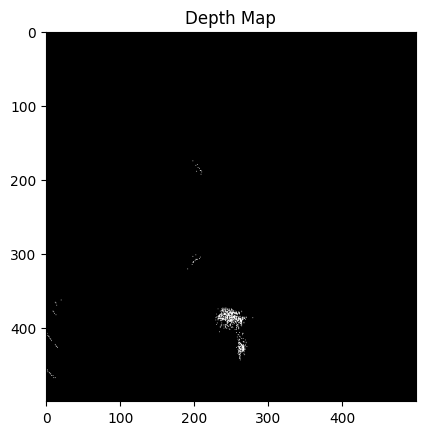

In [18]:
import cv2
import numpy as np

scale = 50  # 调整缩放比例
center = [250, 250]  # 图像中心
img = np.zeros((500, 500), dtype=np.uint8)

max_depth = max(point[2] for cluster in filtered_clusters for point in cluster)
for cluster in filtered_clusters:
    for point in cluster:
        x, y = int(point[0] * scale + center[0]), int(point[1] * scale + center[1])
        if 0 <= x < 500 and 0 <= y < 500:
            img[y, x] = min(255, int(255 * (1 - point[2] / max_depth)))  # 高度信息渐变

cv2.imwrite('Depth_Map.png', img)

# Display the image using matplotlib.pyplot
plt.imshow(img, cmap='gray')  # Use 'gray' colormap for grayscale image
plt.title('Depth Map')
plt.show()